In [1]:
import torch
import numpy as np

In [2]:
n = 200

In [3]:
x = torch.ones(n,2)

In [4]:
x[:,0].uniform_(-1,1)

tensor([-0.9402,  0.4957,  0.7844, -0.2255, -0.2672,  0.3495, -0.8704, -0.3234,
        -0.8880,  0.6952, -0.3663,  0.7474, -0.8006, -0.5947, -0.3805,  0.0388,
        -0.0050,  0.8101, -0.2294, -0.9661,  0.5799, -0.8283, -0.1707, -0.0017,
         0.5346, -0.5443, -0.7296,  0.8287,  0.9637,  0.1724,  0.2267,  0.0606,
        -0.5418, -0.7262,  0.5112, -0.9870, -0.2127, -0.8690, -0.6599,  0.7220,
        -0.1484,  0.3741, -0.3233, -0.3238,  0.5697,  0.8902,  0.2700, -0.6785,
         0.4469, -0.2078, -0.3149, -0.9402,  0.1101,  0.6410, -0.9230, -0.4405,
         0.1918, -0.4300, -0.0286, -0.5977,  0.0494, -0.4096,  0.0900,  0.6701,
         0.2728,  0.6439,  0.9209,  0.9670,  0.3806, -0.2923,  0.2427, -0.4983,
        -0.7788, -0.4829, -0.2992, -0.0147, -0.5265, -0.6645, -0.6460,  0.8385,
         0.5533,  0.6419,  0.8183, -0.0969,  0.7162,  0.0191,  0.3891,  0.6723,
        -0.1827,  0.2501,  0.8369, -0.4034, -0.4482, -0.1608,  0.2995,  0.5180,
         0.6870, -0.6807,  0.6518, -0.33

In [5]:
a = torch.tensor([5.,3])

In [6]:
y = x@a  + torch.rand(n)

In [7]:
a

tensor([5., 3.])

In [8]:
from matplotlib import pyplot as plt

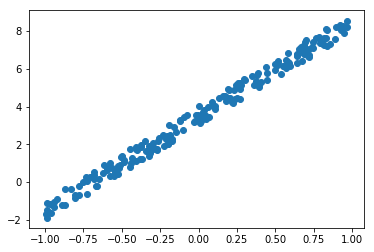

In [9]:
plt.scatter(x[:,0],y)

In [10]:
def mse(y_hat, y): return ((y_hat -y)**2).mean()

In [11]:
from mpl_toolkits import mplot3d

In [12]:
def loss_wrt_wgts(w1,w2):
    w = torch.tensor([w1,w2])
    y_hat = x@w
    return mse(y_hat,y)
loss_gts = np.vectorize(loss_wrt_wgts)

In [13]:
w0_range = np.linspace(-20,20,n)
w1_range = np.linspace(-20,20,n)
mesh = np.meshgrid(w0_range, w1_range)
loss_mesh = loss_gts(*mesh)

In [15]:
def update(w):
    y_hat = x@w
    loss = mse(y_hat,y)
    prev_wgts = w.data.clone()
    loss.backward()
    with torch.no_grad():
        w.sub_(lr*w.grad)
        w.grad.zero_()
    return prev_wgts, loss.item()

In [16]:
def train(w0):
    recorder=[]
    w = torch.tensor(w0, requires_grad=True)
    for t in range(n_epochs): recorder.append(update(w))
    rec_wgts, rec_loss = [list(o) for o in zip(*recorder)]
    rec_wgts= torch.stack(rec_wgts)
    return rec_wgts, rec_loss

In [62]:
lr  =1e-2
n_epochs = 100
w0 = [-18.,18.]
w_y,l_y = train(w0)

In [63]:
print(w_y[:10])
print(l_y[:10])

tensor([[-18.0000,  18.0000],
        [-17.8666,  17.7249],
        [-17.7338,  17.4551],
        [-17.6017,  17.1907],
        [-17.4703,  16.9315],
        [-17.3394,  16.6774],
        [-17.2093,  16.4283],
        [-17.0798,  16.1841],
        [-16.9509,  15.9447],
        [-16.8226,  15.7100]])
[353.1602783203125, 343.8895568847656, 334.9281921386719, 326.2646484375, 317.88787841796875, 309.7872009277344, 301.9522705078125, 294.3733825683594, 287.0409851074219, 279.9459533691406]


In [64]:
from matplotlib.gridspec import GridSpec
from matplotlib import animation, rc
rc('animation', html='jshtml')

In [98]:
lr = 0.03
w_y,l_y = train(w0)
animation.FuncAnimation(fig, animate, range(n_epochs), interval=40)

Animation size has reached 21095624 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
lr = 0.99
w_y,l_y = train(w0)
animation.FuncAnimation(fig, animate, range(n_epochs), interval=40)

In [ ]:
lr = 1
w_y,l_y = train(w0)
animation.FuncAnimation(fig, animate, range(n_epochs), interval=40)

In [ ]:
lr = 2
w_y,l_y = train(w0)
animation.FuncAnimation(fig, animate, range(n_epochs), interval=40)

In [ ]:
##EXPAND for Optimisers